# ResNet50 - Inference

* You can load the recent model using checkpoints, tokenizer and model name.
    * ResNet with 1 GRU Layer Model --> **model_name = 2024-03-27_02-37-10_10000_256_512_10001_46_1**
    * ResNet with 2 GRU Layers Model --> **model_name = 2024-03-27_12-08-05_5000_256_512_10001_46_2**


## Importing Necessary Libraries

In [1]:
import tensorflow as tf
tf.__version__

'2.15.0'

In [2]:
import tensorflow as tf

print("Num GPUs Available: ", len(tf.config.list_physical_devices('GPU')))
if tf.config.list_physical_devices('GPU'):
    print("GPU is available.")
else:
    print("GPU is not available.")


Num GPUs Available:  1
GPU is available.


In [3]:
# from tensorflow.keras import backend as K
# from tensorflow.keras.models import Model
# from tensorflow.keras.layers import Input, Dense, GRU, Embedding
# from tensorflow.keras.applications import VGG16
# from tensorflow.keras.optimizers import RMSprop
# from tensorflow.keras.callbacks import ModelCheckpoint, TensorBoard
# from tensorflow.keras.preprocessing.text import Tokenizer
# from tensorflow.keras.preprocessing.sequence import pad_sequences
# from tensorflow.keras.applications.inception_v3 import InceptionV3
# from tensorflow.keras.applications.inception_v3 import preprocess_input, decode_predictions


# from pathlib import Path
# from os import listdir
# from os.path import isfile, join
# from sklearn.model_selection import train_test_split
# from sklearn.utils import shuffle



import matplotlib.pyplot as plt
import tensorflow as tf
import numpy as np
import os
import pickle
import json
import datetime
import time
import sys
import pandas as pd
from tqdm import tqdm
from PIL import Image
from tensorflow.keras import backend as K
from tensorflow.keras.models import Model
from tensorflow.keras.layers import Dense
from tensorflow.keras.applications import ResNet50
#from tensorflow.keras.preprocessing.sequence import pad_sequences
from tensorflow.keras.applications.resnet50 import ResNet50, preprocess_input

## BahdanauAttention Class

In [4]:
class BahdanauAttention(tf.keras.Model):
    def __init__(self, units):
        super(BahdanauAttention, self).__init__()
        self.W1 = tf.keras.layers.Dense(units)
        self.W2 = tf.keras.layers.Dense(units)
        self.V = tf.keras.layers.Dense(1)

    def call(self, features, hidden):
        # features(CNN_encoder output) shape == (batch_size, 64, embedding_dim)

        # hidden shape == (batch_size, hidden_size)
        # hidden_with_time_axis shape == (batch_size, 1, hidden_size)
        hidden_with_time_axis = tf.expand_dims(hidden, 1)

        # score shape == (batch_size, 64, hidden_size)
        score = tf.nn.tanh(self.W1(features) + self.W2(hidden_with_time_axis))

        # attention_weights shape == (batch_size, 64, 1)
        # you get 1 at the last axis because you are applying score to self.V
        attention_weights = tf.nn.softmax(self.V(score), axis=1)

        # context_vector shape after sum == (batch_size, hidden_size)
        context_vector = attention_weights * features
        context_vector = tf.reduce_sum(context_vector, axis=1)

        return context_vector, attention_weights

### Encoder Class

In [5]:
class CNN_Encoder(tf.keras.Model):
    # Since you have already extracted the features and dumped it using pickle
    # This encoder passes those features through a Fully connected layer
    def __init__(self, embedding_dim):
        super(CNN_Encoder, self).__init__()
        # shape after fc == (batch_size, 64, embedding_dim)
        self.fc = tf.keras.layers.Dense(embedding_dim)

    def call(self, x):
        x = self.fc(x)
        x = tf.nn.relu(x)
        return x

### Decoder Class

In [6]:
#RNN Encoder with more GRU Layers
class RNN_Decoder(tf.keras.Model):
    def __init__(self, embedding_dim, units, vocab_size, num_gru_layers=2):
        super(RNN_Decoder, self).__init__()
        self.units = units

        self.embedding = tf.keras.layers.Embedding(vocab_size, embedding_dim)
        self.gru_layers = [tf.keras.layers.GRU(self.units,
                                               return_sequences=True,
                                               return_state=True,
                                               recurrent_initializer='glorot_uniform') for _ in range(num_gru_layers)]
        self.fc1 = tf.keras.layers.Dense(self.units)
        self.fc2 = tf.keras.layers.Dense(vocab_size)

        self.attention = BahdanauAttention(self.units)

    def call(self, x, features, hidden):
        context_vector, attention_weights = self.attention(features, hidden[-1])

        x = self.embedding(x)

        x = tf.concat([tf.expand_dims(context_vector, 1), x], axis=-1)

        states = []
        for gru_layer in self.gru_layers:
            x, state = gru_layer(x)
            states.append(state)

        x = self.fc1(x)
        # Flatten the output for the Dense layer
        x = tf.reshape(x, (-1, x.shape[2]))

        x = self.fc2(x)

        return x, states, attention_weights

    def reset_state(self, batch_size):
        return [tf.zeros((batch_size, self.units)) for _ in self.gru_layers]

## Restore Model

In [7]:
#model_name = "2024-03-27_02-37-10_10000_256_512_10001_46_1"
model_name = "2024-06-11_03-28-16_100000_256_512_15001_52_2"
model_name.split("_")

['2024-06-11', '03-28-16', '100000', '256', '512', '15001', '52', '2']

### Model Parameter Extraction

In [8]:
number_of_samples =int(model_name.split("_")[-6])
embedding_dim =int(model_name.split("_")[-5])
units =int(model_name.split("_")[-4])
vocab_size =int(model_name.split("_")[-3])
max_length =int(model_name.split("_")[-2])
gru_layers =int(model_name.split("_")[-1])

print(number_of_samples,embedding_dim,units,vocab_size,max_length,gru_layers)

100000 256 512 15001 52 2


In [9]:
# You can change these parameters according to your system's configuration
BATCH_SIZE = 64
BUFFER_SIZE = 1000
#num_steps = 1000 // BATCH_SIZE
features_shape = 2048
attention_features_shape = 49

## Encoder and Decoder Initialization

In [10]:
encoder = CNN_Encoder(embedding_dim)
decoder = RNN_Decoder(embedding_dim, units, vocab_size, gru_layers)

optimizer = tf.keras.optimizers.Adam()

2024-06-13 21:54:11.374742: I metal_plugin/src/device/metal_device.cc:1154] Metal device set to: Apple M3 Pro
2024-06-13 21:54:11.374763: I metal_plugin/src/device/metal_device.cc:296] systemMemory: 36.00 GB
2024-06-13 21:54:11.374767: I metal_plugin/src/device/metal_device.cc:313] maxCacheSize: 13.50 GB
2024-06-13 21:54:11.374792: I tensorflow/core/common_runtime/pluggable_device/pluggable_device_factory.cc:306] Could not identify NUMA node of platform GPU ID 0, defaulting to 0. Your kernel may not have been built with NUMA support.
2024-06-13 21:54:11.374803: I tensorflow/core/common_runtime/pluggable_device/pluggable_device_factory.cc:272] Created TensorFlow device (/job:localhost/replica:0/task:0/device:GPU:0 with 0 MB memory) -> physical PluggableDevice (device: 0, name: METAL, pci bus id: <undefined>)


## Checkpoint Restoration

In [11]:
checkpoint_path = f'checkpoints/bahdanau_{model_name}'

ckpt = tf.train.Checkpoint(encoder=encoder,
                           decoder=decoder,
                           optimizer = optimizer)

ckpt_manager = tf.train.CheckpointManager(ckpt, checkpoint_path, max_to_keep=5)

In [12]:
start_epoch = 0
if ckpt_manager.latest_checkpoint:
    start_epoch = int(ckpt_manager.latest_checkpoint.split('-')[-1])
    # restoring the latest checkpoint in checkpoint_path
    ckpt.restore(ckpt_manager.latest_checkpoint)

In [13]:
ckpt_manager.latest_checkpoint

'checkpoints/bahdanau_2024-06-11_03-28-16_100000_256_512_15001_52_2/ckpt-13'

## Tokenizer Restoration

In [14]:
import pickle

# Load the tokenizer
with open(f'artifacts/tokenizer_{model_name}.pickle', 'rb') as handle:
    tokenizer = pickle.load(handle)

## ResNet Load Image

In [15]:
def load_image(image_path):
    img = tf.io.read_file(image_path)
    img = tf.image.decode_jpeg(img, channels=3)
    img = tf.image.resize(img, (224, 224))  # ResNet50 expects images of size 224x224
    img = preprocess_input(img)  # Use ResNet50's preprocess_input
    return img, image_path

## ResNet Model Initialization

In [16]:
# Load the ResNet50 model pre-trained on ImageNet data
image_model = ResNet50(include_top=False, weights='imagenet')
# The model input and output setup
new_input = image_model.input
hidden_layer = image_model.layers[-1].output  # Use the last layer's output as the feature

# Create a model that will take an image as input and output the features
image_features_extract_model = tf.keras.Model(inputs=new_input, outputs=hidden_layer)

## Evalution

In [17]:
def evaluate(image):
    attention_plot = np.zeros((max_length, attention_features_shape))

    hidden = decoder.reset_state(batch_size=1)

    temp_input = tf.expand_dims(load_image(image)[0], 0)
    img_tensor_val = image_features_extract_model(temp_input)
    img_tensor_val = tf.reshape(img_tensor_val, (img_tensor_val.shape[0], -1, img_tensor_val.shape[3]))

    features = encoder(img_tensor_val)

    dec_input = tf.expand_dims([tokenizer.word_index['<start>']], 0)
    result = []

    for i in range(max_length):
        predictions, hidden, attention_weights = decoder(dec_input, features, hidden)

        attention_plot[i] = tf.reshape(attention_weights, (-1, )).numpy()

        predicted_id = tf.random.categorical(predictions, 1)[0][0].numpy()
        result.append(tokenizer.index_word[predicted_id])

        if tokenizer.index_word[predicted_id] == '<end>':
            return result, attention_plot

        dec_input = tf.expand_dims([predicted_id], 0)

    attention_plot = attention_plot[:len(result), :]
    return result, attention_plot


def plot_attention(image, result, attention_plot):
    temp_image = np.array(Image.open(image))

    fig = plt.figure(figsize=(10, 10))

    len_result = len(result)
    for l in range(len_result):
        temp_att = np.resize(attention_plot[l], (8, 8))
        ax = fig.add_subplot(len_result//2, len_result//2, l+1)
        ax.set_title(result[l])
        img = ax.imshow(temp_image)
        ax.imshow(temp_att, cmap='gray', alpha=0.6, extent=img.get_extent())

    plt.tight_layout()
    plt.show()

## Testing

Prediction caption for IMG_9932.jpg: two men playing with two children and an at the beach <end>


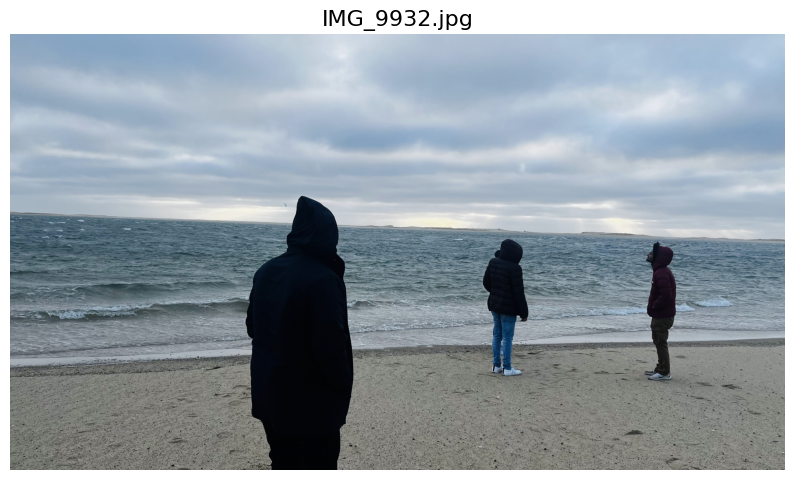

Prediction caption for IMG_9925.jpg: a couple of birds flying over a large white sailboat up in front of a beach during sunset <end>


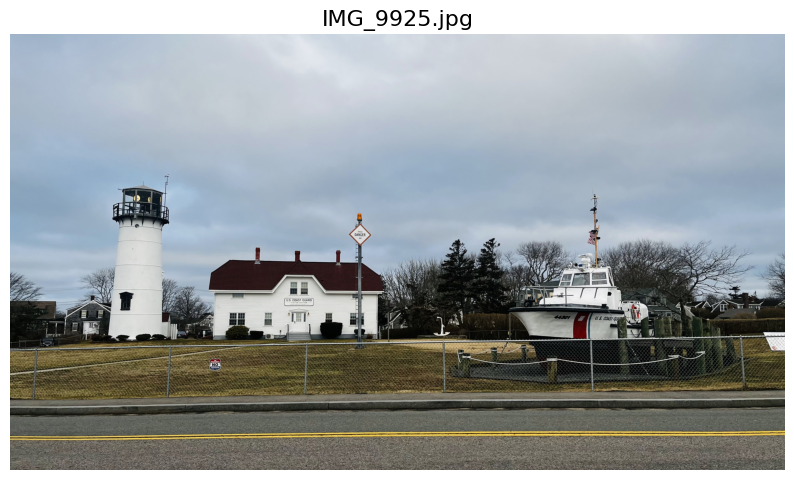

Prediction caption for IMG_9954.jpg: a bird perched on a beach <end>


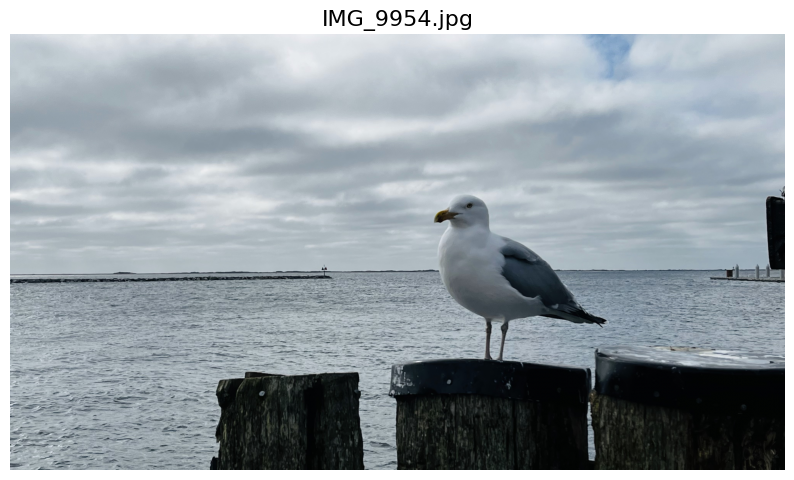

In [18]:
import os
from PIL import Image, ImageFile
# Allow loading of truncated images
ImageFile.LOAD_TRUNCATED_IMAGES = True

def evaluate_images_in_directory(directory, show_images=False):
    """
    Evaluates all images in a specified directory, printing prediction captions for each.
    
    Parameters:
        directory (str): The path to the directory containing images.
        show_images (bool): If True, displays each image as it's processed. Defaults to False.
    """
    # Check if the directory exists
    if not os.path.isdir(directory):
        print(f"The specified directory does not exist: {directory}")
        return

    # Iterate over each file in the directory
    for filename in os.listdir(directory):
        if filename.endswith(('.png', '.jpg', '.jpeg')):  # Checking file extension
            image_path = os.path.join(directory, filename)
            
            try:
                # Run the evaluation function on this image
                result, attention_plot = evaluate(image_path)
                print(f'Prediction caption for {filename}:', ' '.join(result))
                
                # Optionally, display the image
                if show_images:
                    img1 = Image.open(image_path)
                    img1 = np.array(img1)
                    img1 = img1 / 255.0
                    plt.figure(figsize=(10, 10))
                    plt.imshow(img1)
                    plt.title(f'{filename}', fontsize=16)
                    plt.axis('off')  # Hide axes
                    plt.show()
            except IOError as e:
                print(f"Error opening or processing image {filename}: {e}")

# Example usage
evaluate_images_in_directory('./test/', show_images=True)

1793803/1793803 [==============================] - 0s 0us/step
Prediction caption: an adult and baby elephant <end>


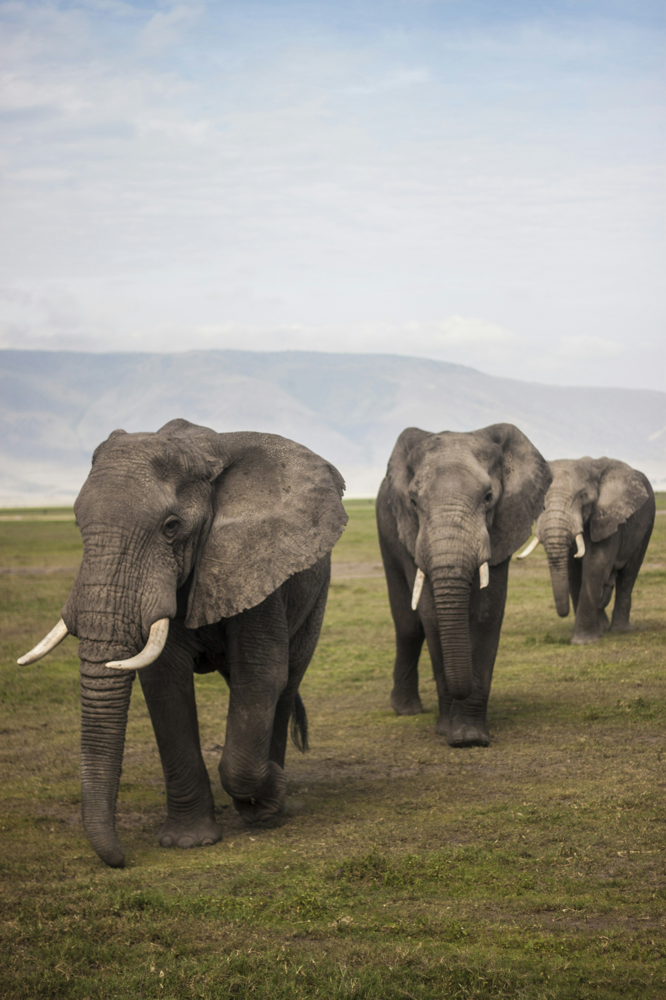

In [19]:
#image_url = 'https://www.hillspet.com/content/dam/cp-sites/hills/hills-pet/en_us/exported/dog-care/Skyword/images/two-dogs-on-beach-at-sunset-SW.jpg'
image_url = 'https://images.unsplash.com/photo-1505148230895-d9a785a555fa?q=80&w=3087&auto=format&fit=crop&ixlib=rb-4.0.3&ixid=M3wxMjA3fDB8MHxwaG90by1wYWdlfHx8fGVufDB8fHx8fA%3D%3D'
image_extension = image_url[-4:]
unique_dir = str(int(time.time()))
image_path = tf.keras.utils.get_file('image'+image_extension,
                                     origin=image_url,
                                    cache_subdir=unique_dir)
        
result, attention_plot = evaluate(image_path)
print ('Prediction caption:', ' '.join(result))
#plot_attention(image_path, result, attention_plot)

# opening the image and compare translation with the image itself
Image.open(image_path)